### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
DATA_VERSION = 'v4'

In [7]:
gov_arch_csv = '../data/' + DATA_VERSION + '/communities_data_prepped.csv'

In [8]:
gov_df = pd.read_csv(gov_arch_csv)

In [9]:
gov_df.head()

,Name,Institutions,Mechanism,Notes,Time span,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocra

In [10]:
# Drop Region: Europe

In [11]:
gov_df['Region: Europe'].sum()

23

In [12]:
gov_df = gov_df[gov_df['Region: Europe'] != 1]

In [13]:
gov_df['Region: Europe'].sum()

0

# Normalized Correlation Matrix

In [14]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [15]:
data_plot.describe()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_popularity_,access_mechanisms_include_payment_for_occupying_office,decision

In [16]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

## Sort all correlations 

In [17]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [18]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [19]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_agenda_setting   enforcement_mechanisms_include_judicial_review    1.0
decision_making_mechanisms_include_lobbying         Geography: Africa West, Mid-western Nigeria       1.0
access_mechanisms_include_lottery_random_selection  Geography: Asia, Japan                            1.0
decision_making_mechanisms_include_mandate          Geography: Middle East, Mesopotamia, Babylonia    1.0
decision_making_mechanisms_include_bureaucracy      decision_making_mechanisms_include_petition       1.0
                                                                                                     ... 
Region: Europe                                      Region: North America                             NaN
                                                    Region: Central America                           NaN
                                                    Region: South America                             NaN
                                              

In [20]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + 'mechanisms_all_correlations_no_europe.csv')

In [21]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start  Time span: Duration                                   -0.682718
                  decision_making_mechanisms_include_assembly_central   -0.580895
Time span: End    decision_making_mechanisms_include_assembly_central   -0.517557
Time span: Start  Region: Middle East                                   -0.502042
                  Geography: Asia, India (northeast)                    -0.489962
                                                                           ...   
Region: Europe    Region: North America                                       NaN
                  Region: Central America                                     NaN
                  Region: South America                                       NaN
                  Region: Oceania                                             NaN
                  Time span: Duration                                         NaN
Length: 14028, dtype: float64


In [22]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/mechanisms_negative_correlations.csv')

# Mechanisms

In [23]:
mechanisms_list = [x for x in gov_df.columns if 'mechanisms_' in x]
mechanisms_list.sort()
mechanisms_list

['access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_blood_relations',
 'access_mechanisms_include_child_participation',
 'access_mechanisms_include_co-optation',
 'access_mechanisms_include_divine_right',
 'access_mechanisms_include_dreaming',
 'access_mechanisms_include_election',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_female_participation',
 'access_mechanisms_include_gerontocracy',
 'access_mechanisms_include_heredity',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_life_appointment',
 'access_mechanisms_include_lottery_random_selection',
 'access_mechanisms_include_matriarchy',
 'access_mechanisms_include_matrilineality',
 'access_mechanisms_include_meritocracy',
 'access_mechanisms_include_open_political_unit',
 'access_mechanisms_include_patronage_for_office',
 'access_mechanisms_include_payment_for_occupying_office',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_pro

In [24]:
access_mechanisms = [x for x in gov_df.columns if 'access_mechanisms_' in x]

In [25]:
decision_making_mechanisms = [x for x in gov_df.columns if 'decision_making_mechanisms_' in x]

In [26]:
enforcement_mechanisms = [x for x in gov_df.columns if 'enforcement_mechanisms_' in x]

In [27]:
# mechanisms_df = gov_df[['Name'] + mechanisms_list]
mechanisms_df = gov_df[mechanisms_list]

In [28]:
mechanisms_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [ ]:
plt.figure(figsize=(40,40))
sns.heatmap(mechanisms_df.corr(),
            cmap='BrBG')

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/mechanisms_correlations.png')
plt.show()

### Look at correlations for specific variables

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=False)

Time span: Duration                                                                1.000000
decision_making_mechanisms_include_assembly_central                                0.483810
Geography: Asia, India (northeast)                                                 0.448791
decision_making_mechanisms_include_consultation                                    0.368467
Size: 100,001 - 1,000,000                                                          0.361450
Region: Middle East                                                                0.338187
access_mechanisms_include_blood_relations                                          0.330532
Geography: Middle East MENA                                                        0.314838
Region: Africa                                                                     0.309404
decision_making_mechanisms_include_board_committee                                 0.296894
Geography: Africa North                                                         

In [31]:
norm_corr['Time span: Duration'].sort_values(ascending=True)

Time span: Start                                                                  -0.682718
Time span: End                                                                    -0.429661
is_SCCS                                                                           -0.344084
Size: 1,001 - 10,000                                                              -0.307269
Region: North America                                                             -0.255759
access_mechanisms_include_gerontocracy                                            -0.239656
Geography: North America                                                          -0.217103
access_mechanisms_include_life_appointment                                        -0.191770
enforcement_mechanisms_include_criticism_mocking_joking                           -0.185797
Size: 100 - 1,000                                                                 -0.177048
enforcement_mechanisms_include_capital_punishment                               

In [32]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.805180
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.738214
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.690033
access_mechanisms_include_election                                                 0.678077
enforcement_mechanisms_include_tribunal_court_                                     0.675046
Size: 100,001 - 1,000,000                                                          0.668569
access_mechanisms_include_blood_relations                                          0.594781
decision_making_mechanisms_include_council_central_                                0.580049
decision_making_mechanisms_include_assembly_central                                0.574891
decision_making_mechanisms_include_magistrate_official                          

In [33]:
norm_corr[['Region: Africa', 'Region: Oceania']]

,Region: Africa,Region: Oceania
Time span: Start,-0.172160,0.137254
Time span: End,-0.084648,0.117256
is_SCCS,-0.066925,0.351492
decision_making_mechanisms_include_representation,0.088995,-0.070738
enforcement_mechanisms_include_police,0.101064,0.074467
enforcement_mechanisms_include_fines,0.049431,-0.069499
decision_making_mechanisms_include_coalition,NaN,NaN
decision_making_mechanisms_include_unanimity,-0.077130,-0.086920
decision_making_mechanisms_include_bureaucracy,0.082649,-0.034400
enforcement_mechanisms_include_reputational_risk,0.119603,-0.069285


In [34]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=True)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include

In [35]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=False)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include

In [36]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.805180
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.738214
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.690033
access_mechanisms_include_election                                                 0.678077
enforcement_mechanisms_include_tribunal_court_                                     0.675046
Size: 100,001 - 1,000,000                                                          0.668569
access_mechanisms_include_blood_relations                                          0.594781
decision_making_mechanisms_include_council_central_                                0.580049
decision_making_mechanisms_include_assembly_central                                0.574891
decision_making_mechanisms_include_magistrate_official                          

In [37]:
norm_corr['decision_making_mechanisms_include_assembly_central'].sort_values(ascending=False)

decision_making_mechanisms_include_assembly_central                                1.000000
Geography: Africa North                                                            0.718938
decision_making_mechanisms_include_magistrate_official                             0.684229
access_mechanisms_include_blood_relations                                          0.652513
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.643507
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.633516
enforcement_mechanisms_include_tribunal_court_                                     0.592913
Region: Africa                                                                     0.574891
Size: 100,001 - 1,000,000                                                          0.561688
access_mechanisms_include_election                                                 0.545313
decision_making_mechanisms_include_council_central_                             

In [38]:
mechanisms_corr_df = norm_corr[mechanisms_list]

In [39]:
mechanisms_corr_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [40]:
query_mechanisms_df = mechanisms_corr_df.transpose()

In [41]:
query_mechanisms_df.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_popularity_,access_mechanisms_include_payment_for_occupying_office,decision

## Time x Mechanism

In [42]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [43]:
time_mechanisms = query_mechanisms_df[time_span_cols]
time_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_age_boundaries,0.009070,0.009531,-0.004053
access_mechanisms_include_blood_relations,-0.286170,-0.216796,0.330532
access_mechanisms_include_child_participation,0.133081,0.095862,-0.165683
access_mechanisms_include_co-optation,NaN,NaN,NaN
access_mechanisms_include_divine_right,-0.201099,-0.216517,0.077296
access_mechanisms_include_dreaming,0.112508,0.084082,-0.132730
access_mechanisms_include_election,-0.085618,-0.043651,0.150118
access_mechanisms_include_enfranchisement,NaN,NaN,NaN
access_mechanisms_include_female_participation,0.220634,0.216024,-0.136793
access_mechanisms_include_gerontocracy,0.109377,0.035940,-0.239656


In [44]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/time_mechanisms.png')
plt.show()

### Time x Mechanism: Access, Decision Making, Enforcement

In [45]:
time_access_mechanisms = time_mechanisms.loc[access_mechanisms]

In [46]:
time_access_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_open_political_unit,0.110988,0.126932,-0.024704
access_mechanisms_include_female_participation,0.220634,0.216024,-0.136793
access_mechanisms_include_induction_rite_ceremony,0.124349,0.124696,-0.069985
access_mechanisms_include_property_requirement,-0.326550,-0.284867,0.286654
access_mechanisms_include_lottery_random_selection,0.060535,0.051131,-0.057187
access_mechanisms_include_child_participation,0.133081,0.095862,-0.165683
access_mechanisms_include_patronage_for_office,-0.056493,-0.042640,0.065631
access_mechanisms_include_meritocracy,0.218300,0.228956,-0.098594
access_mechanisms_include_co-optation,NaN,NaN,NaN
access_mechanisms_include_screening_process,NaN,NaN,NaN


In [47]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/time_access_mechanisms.png')
plt.show()

In [48]:
time_decision_making_mechanisms = time_mechanisms.loc[decision_making_mechanisms]

In [49]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/time_decision_making_mechanisms.png')
plt.show()

In [50]:
time_enforcement_mechanisms = time_mechanisms.loc[enforcement_mechanisms]

In [51]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/time_enforcement_mechanisms.png')
plt.show()

# Region x Mechanism

In [52]:
region_cols = [r for r in list(gov_df) if 'Region: ' in r] 

In [53]:
region_cols

['Region: Africa',
 'Region: Europe',
 'Region: Asia',
 'Region: Middle East',
 'Region: North America',
 'Region: Central America',
 'Region: South America',
 'Region: Oceania']

In [54]:
region_mechanisms = query_mechanisms_df[region_cols]
region_mechanisms

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_mechanisms_include_age_boundaries,0.112395,NaN,-0.155835,-0.078313,-0.019162,-0.077770,0.152770,-0.078697
access_mechanisms_include_blood_relations,0.594781,NaN,0.131905,-0.102387,-0.108506,0.017367,-0.020371,0.039713
access_mechanisms_include_child_participation,-0.096920,NaN,-0.139385,-0.070046,0.282338,-0.069561,-0.062218,0.171847
access_mechanisms_include_co-optation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_divine_right,0.063598,NaN,-0.138100,0.071624,0.017906,-0.068919,-0.061645,-0.069740
access_mechanisms_include_dreaming,-0.083224,NaN,0.109114,-0.060148,0.055855,-0.059731,-0.053426,-0.060442
access_mechanisms_include_election,0.678077,NaN,-0.036386,-0.118217,-0.000276,0.002123,-0.105006,-0.118796
access_mechanisms_include_enfranchisement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_female_participation,0.073499,NaN,-0.208758,-0.178606,0.259142,-0.177367,-0.158645,0.163513
access_mechanisms_include_gerontocracy,-0.119622,NaN,-0.046271,-0.163689,0.276695,-0.171928,-0.072303,0.074894


In [55]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_mechanisms = region_mechanisms[cols_to_move + [col for col in region_mechanisms.columns if col not in cols_to_move]]

In [56]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/region_mechanisms.png')
plt.show()

### Region x Mechanism: Access, Decision Making, Enforcement

In [57]:
region_access_mechanisms = region_mechanisms.loc[access_mechanisms]

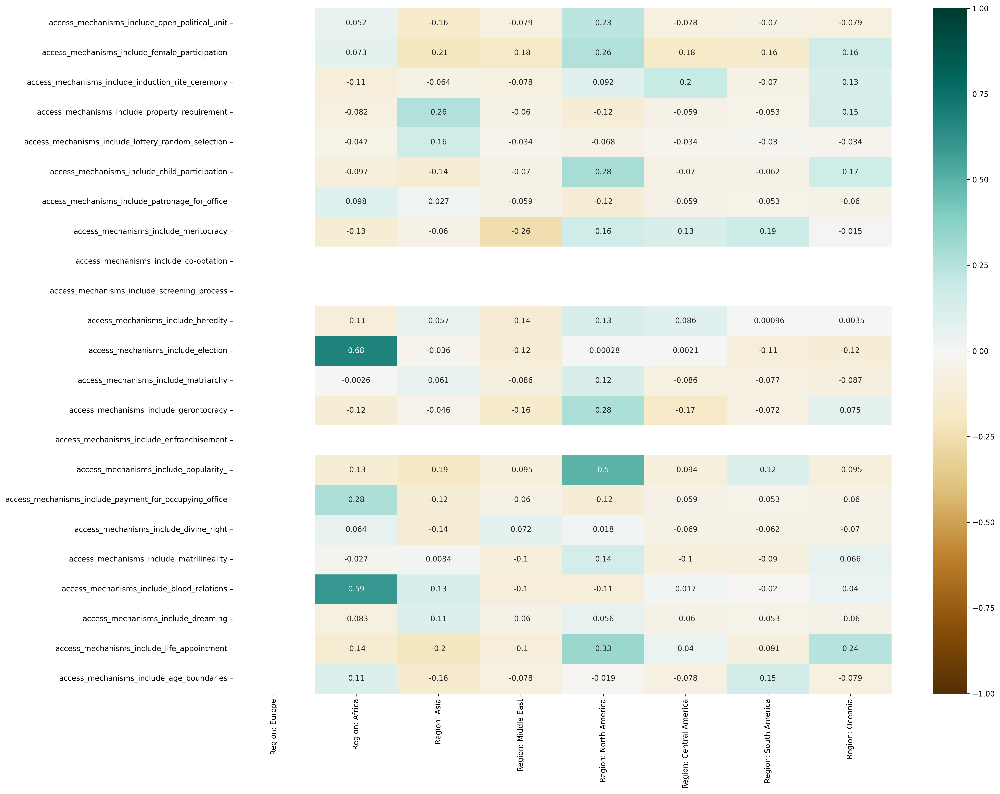

In [58]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/region_access_mechanisms.png')
plt.show()

In [59]:
region_decision_making_mechanisms = region_mechanisms.loc[decision_making_mechanisms]

In [60]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/region_decision_making_mechanisms.png')
plt.show()

In [61]:
region_enforcement_mechanisms = region_mechanisms.loc[enforcement_mechanisms]

In [62]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/region_enforcement_mechanisms.png')
plt.show()

# Size x Mechanism

In [63]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [64]:
size_mechanisms = query_mechanisms_df[size_cols]

In [65]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/size_mechanisms.png')
plt.show()

### Size x Mechanism: Access, Decision Making, Enforcement

In [66]:
size_access_mechanisms = size_mechanisms.loc[access_mechanisms]

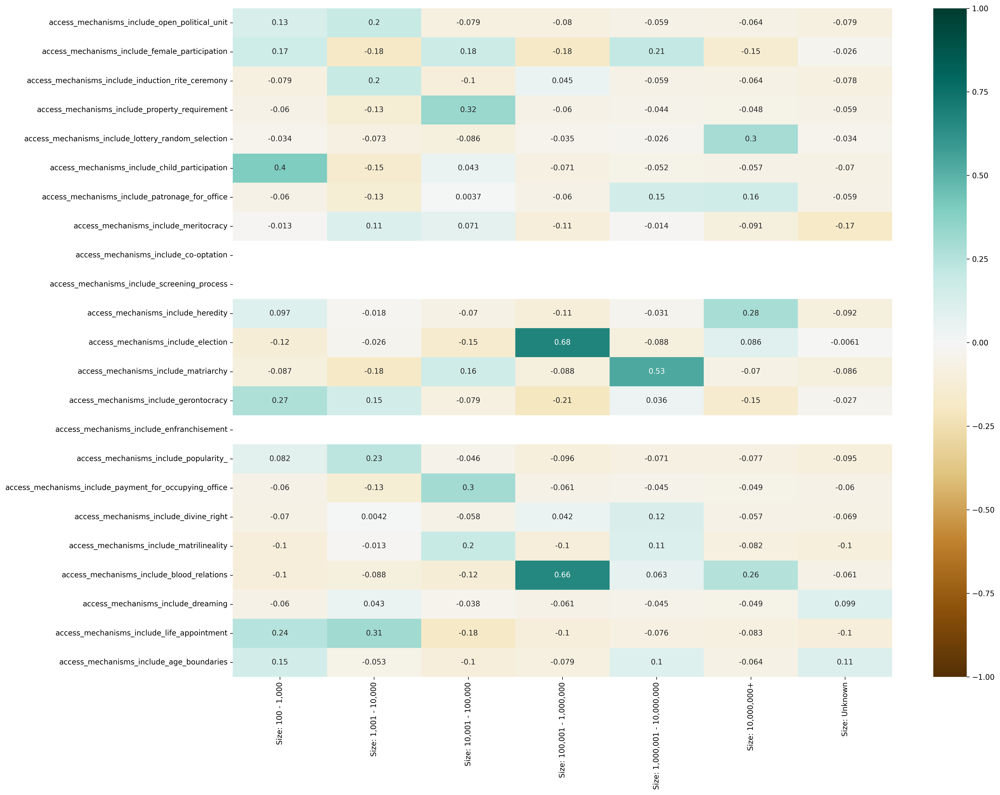

In [67]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/size_access_mechanisms.png')
plt.show()

In [68]:
size_decision_making_mechanisms = size_mechanisms.loc[decision_making_mechanisms]

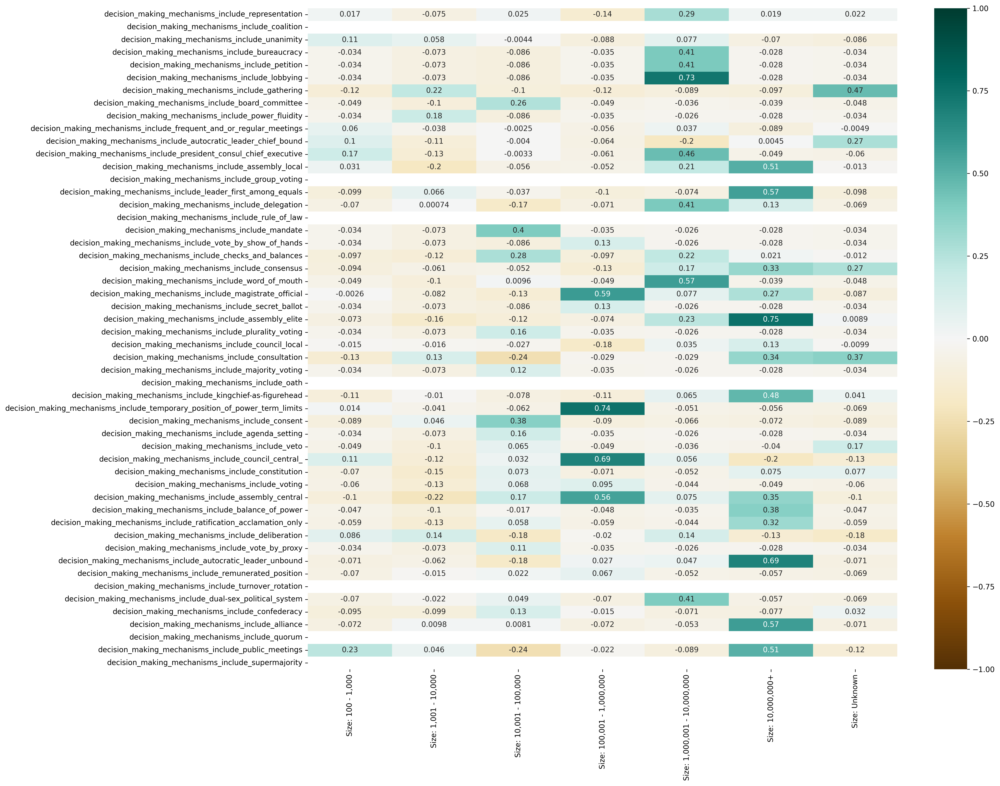

In [69]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/size_decision_making_mechanisms.png')
plt.show()

In [70]:
size_enforcement_mechanisms = size_mechanisms.loc[enforcement_mechanisms]

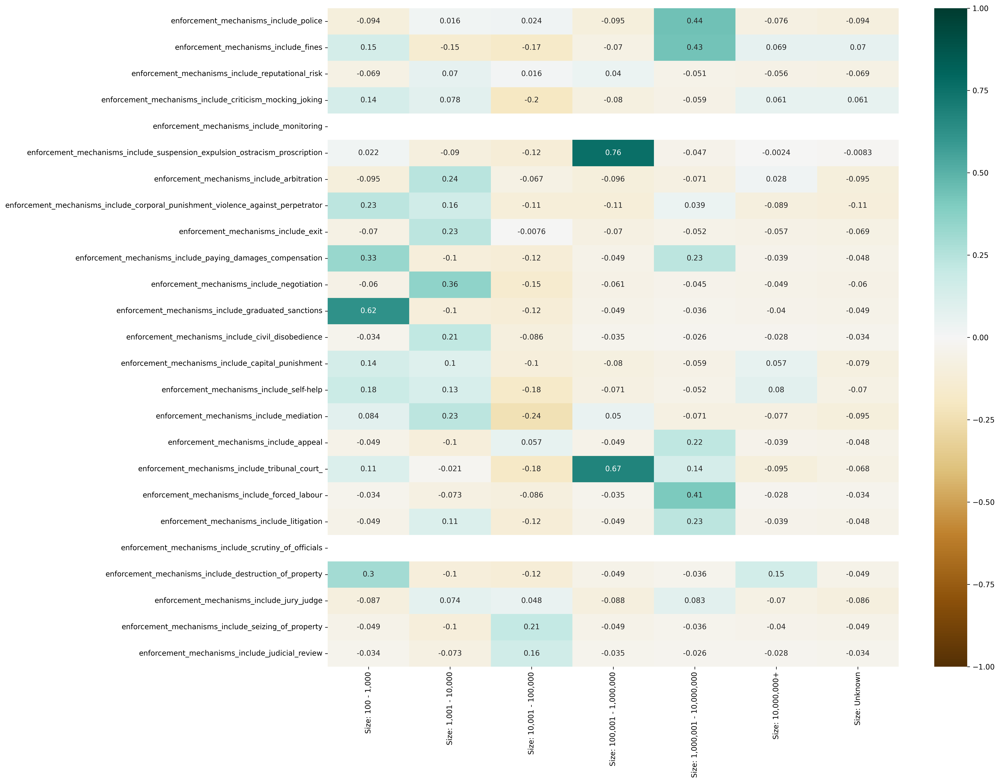

In [71]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/size_enforcement_mechanisms.png')
plt.show()

# Query and sort for mechanisms

In [72]:
def query_mech(col_name, ascending=False):
    # Return a sorted frame for a single column
    return query_mechanisms_df[col_name].sort_values(ascending=ascending)

In [73]:
query_mechanisms_df['Time span: Start'].sort_values(ascending=False)

decision_making_mechanisms_include_deliberation                                    0.229783
access_mechanisms_include_female_participation                                     0.220634
access_mechanisms_include_meritocracy                                              0.218300
decision_making_mechanisms_include_council_local                                   0.208481
access_mechanisms_include_life_appointment                                         0.184072
access_mechanisms_include_matrilineality                                           0.172249
access_mechanisms_include_popularity_                                              0.157524
enforcement_mechanisms_include_arbitration                                         0.154439
enforcement_mechanisms_include_criticism_mocking_joking                            0.149753
enforcement_mechanisms_include_mediation                                           0.148644
enforcement_mechanisms_include_capital_punishment                               

In [74]:
query_mech('Time span: Duration')

decision_making_mechanisms_include_assembly_central                                0.483810
decision_making_mechanisms_include_consultation                                    0.368467
access_mechanisms_include_blood_relations                                          0.330532
decision_making_mechanisms_include_board_committee                                 0.296894
access_mechanisms_include_property_requirement                                     0.286654
decision_making_mechanisms_include_council_central_                                0.282358
decision_making_mechanisms_include_autocratic_leader_unbound                       0.275886
decision_making_mechanisms_include_assembly_elite                                  0.260447
decision_making_mechanisms_include_petition                                        0.237167
decision_making_mechanisms_include_bureaucracy                                     0.237167
enforcement_mechanisms_include_forced_labour                                    

In [75]:
query_mech('Time span: Duration', ascending=True)

access_mechanisms_include_gerontocracy                                            -0.239656
access_mechanisms_include_life_appointment                                        -0.191770
enforcement_mechanisms_include_criticism_mocking_joking                           -0.185797
enforcement_mechanisms_include_capital_punishment                                 -0.176730
access_mechanisms_include_child_participation                                     -0.165683
enforcement_mechanisms_include_self-help                                          -0.160345
access_mechanisms_include_matrilineality                                          -0.155410
access_mechanisms_include_female_participation                                    -0.136793
access_mechanisms_include_dreaming                                                -0.132730
decision_making_mechanisms_include_council_local                                  -0.130074
access_mechanisms_include_heredity                                              

In [76]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Correlations: Community Mechanisms', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/mechanisms_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_68816/2739610315.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [77]:
plt.figure(figsize=(20,50))

heatmap = sns.heatmap(
    norm_corr[['Time span: Duration']].dropna().sort_values(
        by='Time span: Duration', 
        ascending=False), 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    annot_kws={"size": 8},
    xticklabels=1, 
    yticklabels=1, 
    cmap='BrBG')

heatmap.set_title('Features Correlating with Time span: Duration', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/duration_correlations.png')
plt.show()

# Time x Region x Size

In [78]:
norm_corr[time_span_cols + region_cols + size_cols]

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.953136,-0.682718,-0.172160,NaN,-0.218814,-0.502042,0.270451,0.093573,0.121943,0.137254,0.148145,0.301039,-0.346261,-0.249976,-0.071390,-0.165642,0.024409
Time span: End,0.953136,1.000000,-0.429661,-0.084648,NaN,-0.179549,-0.480405,0.228330,0.137691,0.103517,0.117256,0.109773,0.244804,-0.358940,-0.159264,-0.028239,-0.120034,0.104404
is_SCCS,0.380863,0.328209,-0.344084,-0.066925,NaN,-0.276049,-0.219977,0.174653,-0.126373,0.210278,0.351492,0.224406,0.287341,-0.191628,-0.112066,-0.164219,-0.179094,-0.043416
decision_making_mechanisms_include_representation,-0.008865,0.081513,0.223324,0.088995,NaN,0.215090,-0.189786,-0.030320,-0.188470,-0.168576,-0.070738,0.016986,-0.075036,0.025028,-0.142520,0.288517,0.018650,0.021898
enforcement_mechanisms_include_police,0.027674,0.065739,0.076172,0.101064,NaN,-0.186490,-0.093719,0.142713,-0.093069,-0.083245,0.074467,-0.094219,0.015849,0.023947,-0.095091,0.437869,-0.076301,-0.093619
enforcement_mechanisms_include_fines,0.101391,0.108531,-0.040502,0.049431,NaN,0.151123,-0.069161,-0.136653,-0.068681,-0.061432,-0.069499,0.147854,-0.147924,-0.173836,-0.070174,0.430912,0.068575,0.070299
decision_making_mechanisms_include_coalition,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_mechanisms_include_unanimity,0.050872,0.022596,-0.097264,-0.077130,NaN,-0.172119,-0.086497,0.470802,-0.085897,-0.076830,-0.086920,0.106721,0.058373,-0.004406,-0.087764,0.076911,-0.070422,-0.086405
decision_making_mechanisms_include_bureaucracy,-0.279950,-0.247767,0.237167,0.082649,NaN,-0.068118,-0.034232,-0.067638,-0.033995,-0.030406,-0.034400,-0.034415,-0.073217,-0.086042,-0.034734,0.406745,-0.027870,-0.034196
enforcement_mechanisms_include_reputational_risk,0.103495,0.108073,-0.047889,0.119603,NaN,-0.137198,-0.068948,-0.136232,-0.068470,0.457948,-0.069285,-0.069316,0.069921,0.015542,0.039609,-0.051471,-0.056134,-0.068874


In [79]:
time_region_size = norm_corr[time_span_cols + region_cols + size_cols].loc[time_span_cols + region_cols + size_cols]

In [80]:
time_region_size

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.953136,-0.682718,-0.172160,NaN,-0.218814,-0.502042,0.270451,0.093573,0.121943,0.137254,0.148145,0.301039,-0.346261,-0.249976,-0.071390,-0.165642,0.024409
Time span: End,0.953136,1.000000,-0.429661,-0.084648,NaN,-0.179549,-0.480405,0.228330,0.137691,0.103517,0.117256,0.109773,0.244804,-0.358940,-0.159264,-0.028239,-0.120034,0.104404
Time span: Duration,-0.682718,-0.429661,1.000000,0.309404,NaN,0.219451,0.338187,-0.255759,0.053258,-0.113951,-0.126471,-0.177048,-0.307269,0.166586,0.361450,0.144876,0.204488,0.179298
Region: Africa,-0.172160,-0.084648,0.309404,1.000000,NaN,-0.216171,-0.108635,-0.214648,-0.107881,-0.096494,-0.109167,-0.109215,-0.053913,-0.076888,0.668569,0.142559,-0.088445,0.012953
Region: Europe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Region: Asia,-0.218814,-0.179549,0.219451,-0.216171,NaN,1.000000,-0.156233,-0.308695,-0.155149,-0.138773,-0.156997,-0.059717,-0.208967,0.062683,-0.158521,-0.000735,0.621243,0.024259
Region: Middle East,-0.502042,-0.480405,0.338187,-0.108635,NaN,-0.156233,1.000000,-0.155132,-0.077969,-0.069739,-0.078897,-0.078932,-0.167927,0.237338,-0.006773,-0.058612,-0.063922,0.442665
Region: North America,0.270451,0.228330,-0.255759,-0.214648,NaN,-0.308695,-0.155132,1.000000,-0.154056,-0.137795,-0.155891,0.360273,0.292802,-0.111595,-0.157404,-0.115810,-0.126301,-0.154967
Region: Central America,0.093573,0.137691,0.053258,-0.107881,NaN,-0.155149,-0.077969,-0.154056,1.000000,-0.069255,-0.078350,-0.078385,-0.062992,-0.195974,0.333005,-0.058206,-0.063478,-0.077886
Region: South America,0.121943,0.103517,-0.113951,-0.096494,NaN,-0.138773,-0.069739,-0.137795,-0.069255,1.000000,-0.070080,-0.070111,0.111230,-0.076941,0.049703,-0.052062,-0.056778,-0.069665


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_68816/3783224638.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))


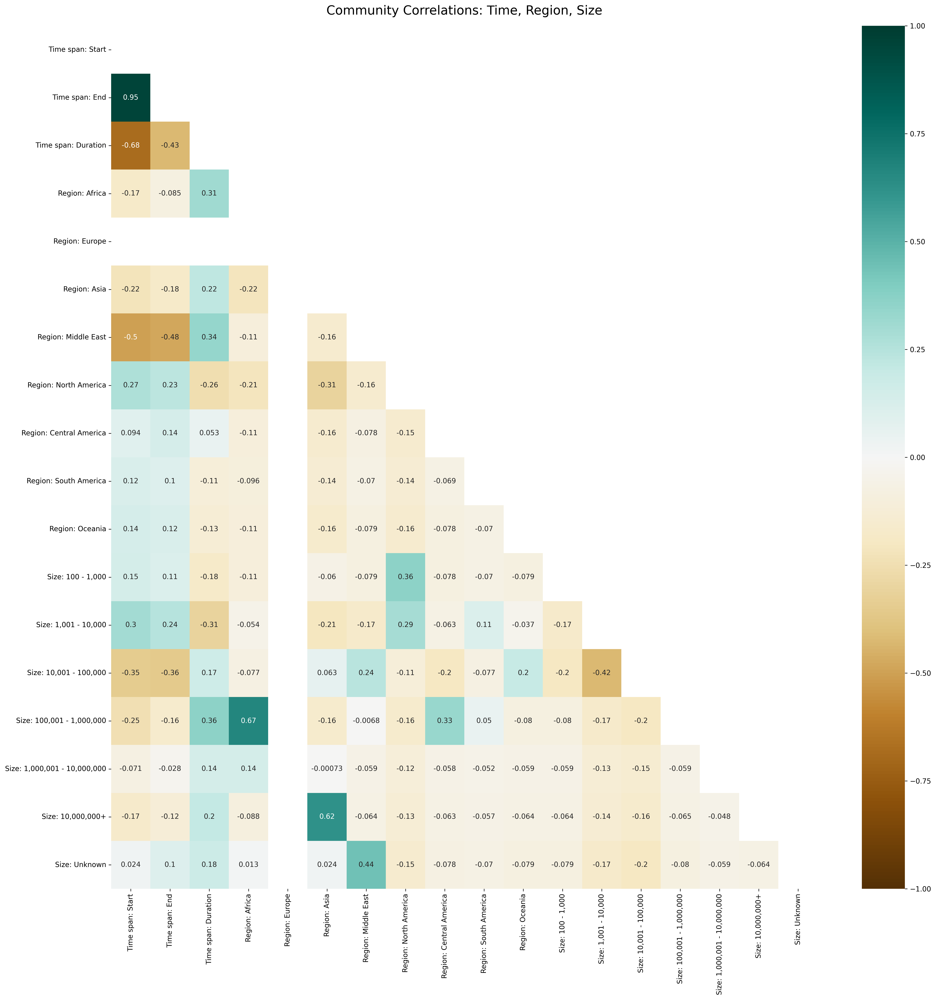

In [81]:
plt.figure(figsize=(20, 20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    time_region_size, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Community Correlations: Time, Region, Size', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/communities_time_region_size.png')
plt.show()

## Time

In [82]:
time_corr = norm_corr[time_span_cols].loc[region_cols + size_cols]

In [83]:
time_corr

,Time span: Start,Time span: End,Time span: Duration
Region: Africa,-0.172160,-0.084648,0.309404
Region: Europe,NaN,NaN,NaN
Region: Asia,-0.218814,-0.179549,0.219451
Region: Middle East,-0.502042,-0.480405,0.338187
Region: North America,0.270451,0.228330,-0.255759
Region: Central America,0.093573,0.137691,0.053258
Region: South America,0.121943,0.103517,-0.113951
Region: Oceania,0.137254,0.117256,-0.126471
"Size: 100 - 1,000",0.148145,0.109773,-0.177048
"Size: 1,001 - 10,000",0.301039,0.244804,-0.307269


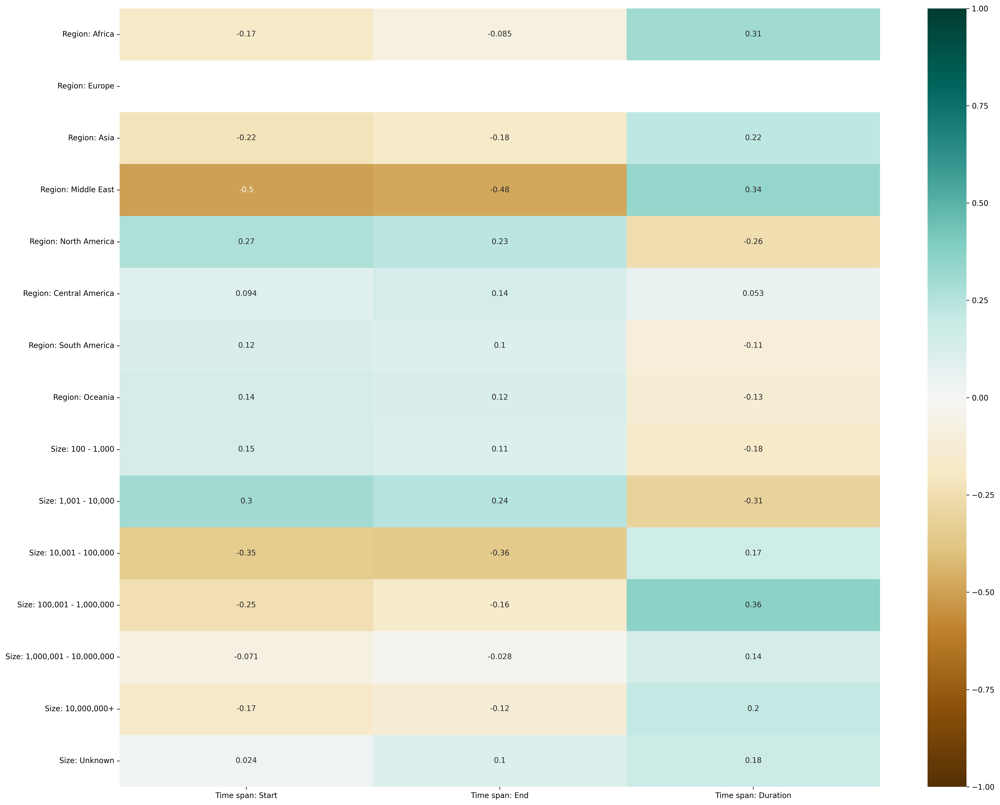

In [84]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/communities_time_correlations.png')
plt.show()

## Region

In [85]:
region_corr = norm_corr[region_cols].loc[time_span_cols + size_cols]

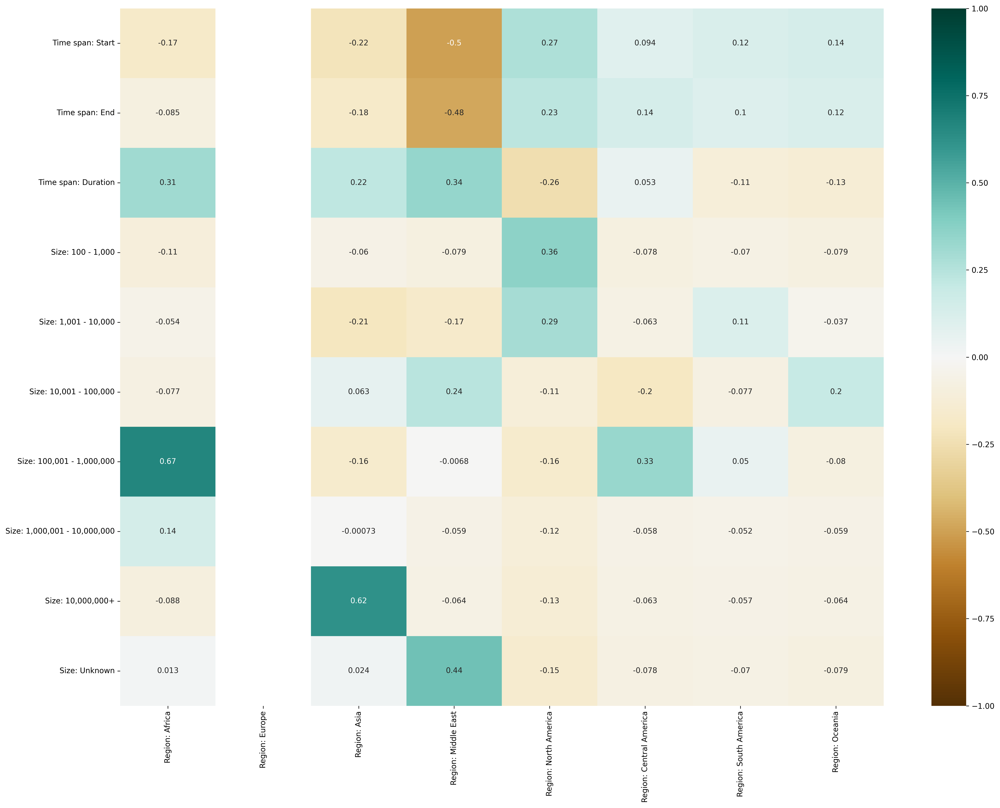

In [86]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/communities_region_correlations.png')
plt.show()

## Size 

In [87]:
size_corr = norm_corr[size_cols].loc[time_span_cols + region_cols]

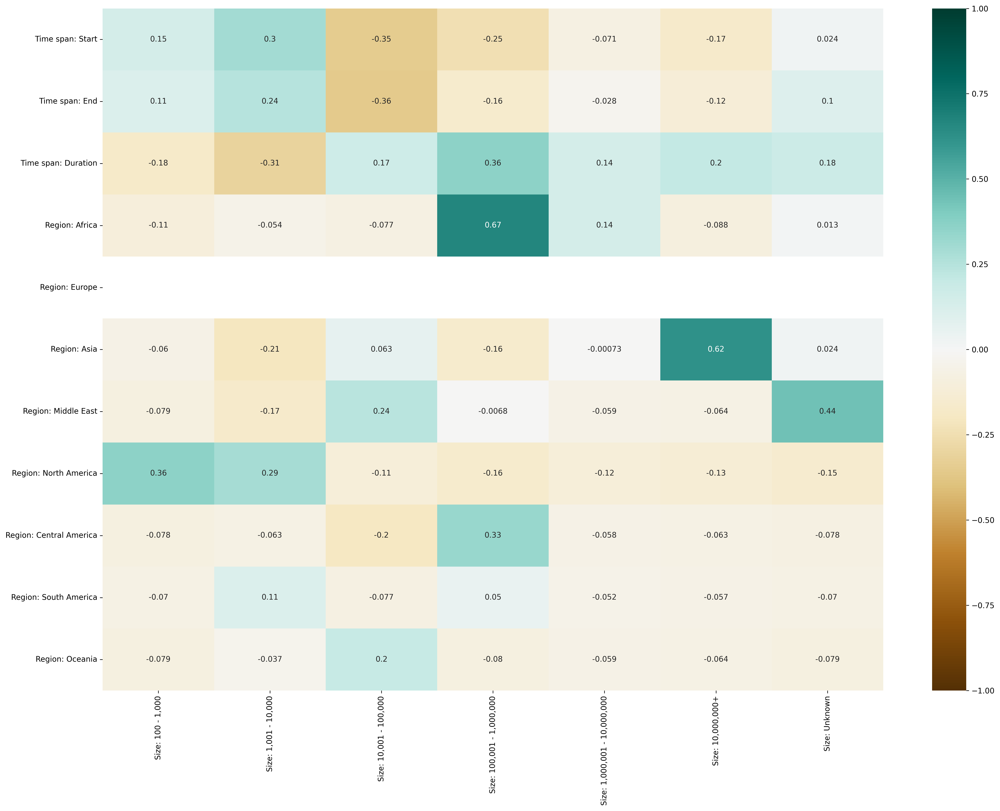

In [88]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../' + DATA_VERSION + '-fig/fig-correlations-no-eu/communities_size_correlations.png')
plt.show()